In [2]:
import pandas as pd
import json      # library for working with JSON-formatted text strings
import requests  # library for accessing content from web URLs
import pprint    # library for cleanly printing Python data structures
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
pp = pprint.PrettyPrinter()

In [3]:
import geopandas as gpd
import networkx as nx
import osmnx as ox
from descartes import PolygonPatch
from shapely.geometry import LineString
from shapely.geometry import Point
from shapely.geometry import Polygon
import seaborn as sns

In [4]:
#@title 縣市選擇
# location = "\u53F0\u4E2D\u5E02" #@param ['台北市','苗栗縣','花蓮縣','台中市','台中縣','台東縣','基隆市','南投縣','澎湖縣','台南市','彰化縣','陽明山','高雄市','雲林縣','金門縣','台北縣','嘉義縣','連江縣','宜蘭縣','台南縣','嘉義市','桃園縣','高雄縣','新竹市','新竹縣','屏東縣']
location = "台北市"

location_str = """台北市 A 苗栗縣 K 花蓮縣 U
台中市 B 台中縣 L 台東縣 V
基隆市 C 南投縣 M 澎湖縣 X
台南市 D 彰化縣 N 陽明山 Y
高雄市 E 雲林縣 P 金門縣 W
台北縣 F 嘉義縣 Q 連江縣 Z
宜蘭縣 G 台南縣 R 嘉義市 I
桃園縣 H 高雄縣 S 新竹市 O
新竹縣 J 屏東縣 T"""

locToLetter = dict(zip(location_str.split()[::2], location_str.lower().split()[1::2]))

import os
import pandas as pd

# 歷年資料夾
dirs = [d for d in os.listdir() if d[:5] == 'real_']

dfs = []

for d in dirs:
    df = pd.read_csv(os.path.join(d,locToLetter[location] + '_lvr_land_a.csv'), index_col=False)
    df['Q'] = d[-1]
    dfs.append(df.iloc[1:])

df = pd.concat(dfs, sort=True)

# 新增交易年份
df['year'] = pd.to_numeric(df['交易年月日'].str[:-4], errors='coerce') + 1911

# 平方公尺換成坪
df['單價元平方公尺'] = df['單價元平方公尺'].astype(float)
df['price: NTD/ping'] = df['單價元平方公尺'] * 3.30579

# 建物型態
df['建物型態2'] = df['建物型態'].str.split('(').str[0]

# 刪除有備註之交易（多為親友交易、價格不正常之交易）
df = df[df['備註'].isnull()]

# 將index改成年月日
df.index = pd.to_datetime(df['year'].astype(str) + df['交易年月日'].str[-4:] ,errors='coerce')
df.sort_index(inplace=True)

df['District'] = df['鄉鎮市區'].replace({
    '松山區': 'Songshan District', 
    '信義區': 'Xinyi District',
    "大安區": "Da'an District",
    '中山區': 'Zhongshan District',
    '中正區': 'Zhongzheng District',
    '大同區': 'Datong District',   
    '萬華區': 'Wanhua District',
    '文山區': 'Wenshan District', 
    '南港區': 'Nangang District',
    '內湖區': 'Neihu District',
    '士林區': 'Shilin District',
    '北投區': 'Beitou District'})

df = df[df['year'].between(2012, 2023)]

df.head()

,Q,主建物面積,主要建材,主要用途,交易年月日,交易標的,交易筆棟數,備註,單價元平方公尺,土地位置建物門牌,...,鄉鎮市區,附屬建物面積,陽台面積,電梯,非都市土地使用分區,非都市土地使用編定,year,price: NTD/ping,建物型態2,District
2012-01-01,3,32.66,鋼筋混凝土造,住家用,1010101,房地(土地+建物),土地1建物1車位0,NaN,243762.0,臺北市中正區中華路一段７號十一樓之5,...,中正區,0.0,3.14,NaN,NaN,NaN,2012,8.058260e+05,套房,Zhongzheng District
2012-01-01,1,175.81,鋼骨鋼筋混凝土造,住家用,1010101,房地(土地+建物)+車位,土地1建物1車位3,NaN,307695.0,臺北市大安區潮州街６５號五樓,...,大安區,7.15,33.31,NaN,NaN,NaN,2012,1.017175e+06,住宅大樓,Da'an District
2012-01-02,2,39.26,鋼筋混凝土造,見其他登記事項,1010102,房地(土地+建物),土地1建物1車位0,NaN,184922.0,臺北市信義區吳興街600巷76弄22號2樓之2,...,信義區,5.22,3.64,NaN,NaN,NaN,2012,6.113133e+05,華廈,Xinyi District
2012-01-03,1,30.8,鋼筋混凝土造,住家用,1010103,房地(土地+建物)+車位,土地1建物1車位1,NaN,199203.0,台北市中山區恆安里新生北路三段１6號9樓之1,...,中山區,3.67,1.95,NaN,NaN,NaN,2012,6.585233e+05,套房,Zhongshan District
2012-01-05,2,121.42,鋼筋混凝土造,見其他登記事項,1010105,房地(土地+建物)+車位,土地2建物1車位2,NaN,248235.0,台北市中正區汀州路一段７２號二十樓,...,中正區,12.37,8.78,NaN,NaN,NaN,2012,8.206128e+05,住宅大樓,Zhongzheng District


In [5]:
condition = (df['主要用途'] == '住家用') & (df['year'].between(2012, 2023))

address_district_df = df.loc[condition, ['土地位置建物門牌', '鄉鎮市區', 'District', 'year', 'price: NTD/ping']].copy()
address_district_df

,土地位置建物門牌,鄉鎮市區,District,year,price: NTD/ping
2012-01-01,臺北市中正區中華路一段７號十一樓之5,中正區,Zhongzheng District,2012,8.058260e+05
2012-01-01,臺北市大安區潮州街６５號五樓,大安區,Da'an District,2012,1.017175e+06
2012-01-03,台北市中山區恆安里新生北路三段１6號9樓之1,中山區,Zhongshan District,2012,6.585233e+05
2012-01-05,臺北市中正區中華路一段７號八樓之5,中正區,Zhongzheng District,2012,8.116871e+05
2012-01-05,臺北市文山區保儀路６２之２號１６樓,文山區,Wenshan District,2012,5.259181e+05
...,...,...,...,...,...
NaT,臺北市北投區大同街109號5樓,北投區,Beitou District,2015,6.823878e+05
NaT,臺北市中山區民權東路三段５９號二樓,中山區,Zhongshan District,2015,8.944245e+05
NaT,臺北市中山區民權東路三段５９號三樓,中山區,Zhongshan District,2015,8.944245e+05
NaT,臺北市中山區民權東路三段５９號四樓,中山區,Zhongshan District,2015,8.944245e+05


In [6]:
import math

# 計算需要分割成多少個 CSV 文件 for Google Earth Pro (Max=2500)
num_files = math.ceil(len(address_district_df) / 2500)

# 將 DataFrame 拆分為多個小的 DataFrame
dfs_for_Google_Earth = [address_district_df[i * 2500:(i + 1) * 2500] for i in range(num_files)]

# 將每個小 DataFrame 寫入 CSV 文件
for i, small_df in enumerate(dfs_for_Google_Earth):
    file_path = f"address/data_{i+1}.csv"
    small_df.to_csv(file_path, index=False, encoding='utf-8')

In [7]:
df.shape

(136722, 39)

In [8]:
print(df.head())

            Q   主建物面積      主要建材     主要用途    交易年月日          交易標的      交易筆棟數  \
2012-01-01  3   32.66    鋼筋混凝土造      住家用  1010101     房地(土地+建物)  土地1建物1車位0   
2012-01-01  1  175.81  鋼骨鋼筋混凝土造      住家用  1010101  房地(土地+建物)+車位  土地1建物1車位3   
2012-01-02  2   39.26    鋼筋混凝土造  見其他登記事項  1010102     房地(土地+建物)  土地1建物1車位0   
2012-01-03  1    30.8    鋼筋混凝土造      住家用  1010103  房地(土地+建物)+車位  土地1建物1車位1   
2012-01-05  2  121.42    鋼筋混凝土造  見其他登記事項  1010105  房地(土地+建物)+車位  土地2建物1車位2   

             備註   單價元平方公尺                 土地位置建物門牌  ... 鄉鎮市區 附屬建物面積   陽台面積  \
2012-01-01  NaN  243762.0       臺北市中正區中華路一段７號十一樓之5  ...  中正區    0.0   3.14   
2012-01-01  NaN  307695.0           臺北市大安區潮州街６５號五樓  ...  大安區   7.15  33.31   
2012-01-02  NaN  184922.0  臺北市信義區吳興街600巷76弄22號2樓之2  ...  信義區   5.22   3.64   
2012-01-03  NaN  199203.0   台北市中山區恆安里新生北路三段１6號9樓之1  ...  中山區   3.67   1.95   
2012-01-05  NaN  248235.0        台北市中正區汀州路一段７２號二十樓  ...  中正區  12.37   8.78   

             電梯 非都市土地使用分區 非都市土地使用編定  year price: NTD/ping 建物型態

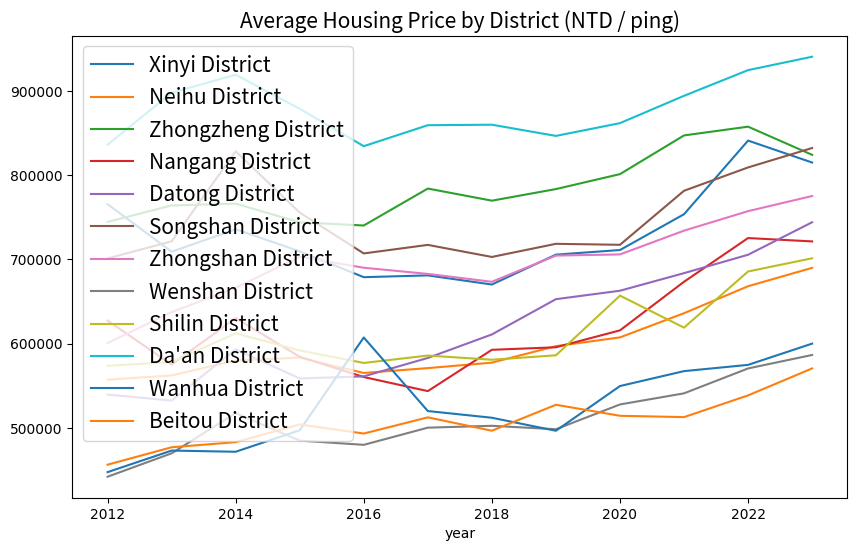

In [9]:
#@title 數據分析
from matplotlib.font_manager import FontProperties
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (10, 6)

# 自定義字體變數
myfont = FontProperties(fname=r'taipei_sans_tc_beta.ttf')
myfont.set_size(15)

prices = {}
for district in set(df['District']):
    cond = (
        (df['主要用途'] == '住家用')
        & (df['District'] == district)
        & (df['price: NTD/ping'] < df["price: NTD/ping"].quantile(0.95))
        & (df['price: NTD/ping'] > df["price: NTD/ping"].quantile(0.05))
        )
    groups = df[cond]['year']
    prices[district] = df[cond]['price: NTD/ping'].astype(float).groupby(groups).mean().loc[2012:]

price_history = pd.DataFrame(prices)
price_history.plot()
plt.title('Average Housing Price by District (NTD / ping)',fontproperties=myfont)
plt.legend(prop=myfont)
plt.savefig('images/avg_h_p.png', dpi=300)
plt.show()

In [10]:
import geopandas as gpd
# Read shp data of Taipei
# Boundary
shapefile_path = "district/Taipei.shp"
District_data = gpd.read_file(shapefile_path, encoding="utf-8")
District_data.head()

,TOWNID,TOWNCODE,COUNTYNAME,TOWNNAME,TOWNENG,COUNTYID,COUNTYCODE,geometry
0,A02,63000030,臺北市,大安區,Da'an District,A,63000,"POLYGON ((121.54385 25.04490, 121.54408 25.044..."
1,A11,63000080,臺北市,文山區,Wenshan District,A,63000,"POLYGON ((121.59726 25.01438, 121.59725 25.014..."
2,F33,65000040,新北市,永和區,Yonghe District,F,65000,"POLYGON ((121.51240 25.02174, 121.51256 25.021..."
3,F07,65000060,新北市,新店區,Xindian District,F,65000,"POLYGON ((121.60923 24.96402, 121.60930 24.963..."
4,F19,65000130,新北市,土城區,Tucheng District,F,65000,"POLYGON ((121.46715 24.99298, 121.46717 24.993..."


<Axes: >

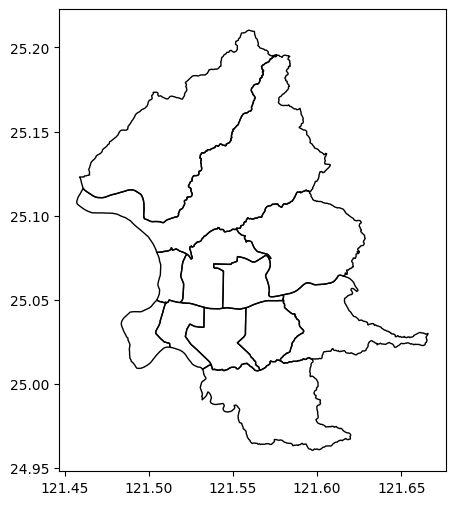

In [11]:
## plot data
District_data = District_data[(District_data['COUNTYNAME']=='臺北市')]
District_data = District_data.loc[:, ['TOWNNAME', 'TOWNENG', 'geometry']]
District_data.plot(edgecolor='black', facecolor='none')

In [12]:
# 讀取房價資料，並進行轉換
price_history.reset_index(inplace=True)
price_data = price_history.melt(id_vars='year', var_name='TOWNENG', value_name='price')
price_data

,year,TOWNENG,price
0,2012,Xinyi District,765374.608635
1,2013,Xinyi District,709053.653930
2,2014,Xinyi District,735686.609873
3,2015,Xinyi District,709500.404465
4,2016,Xinyi District,678806.542778
...,...,...,...
139,2019,Beitou District,527394.630933
140,2020,Beitou District,514330.832415
141,2021,Beitou District,512734.773878
142,2022,Beitou District,538524.430686


In [13]:
merged_data = pd.merge(District_data, price_data, on='TOWNENG', how='left')
merged_data['price_thousands'] = (merged_data['price'] / 1000).round().astype(int)
merged_data

,TOWNNAME,TOWNENG,geometry,year,price,price_thousands
0,大安區,Da'an District,"POLYGON ((121.54385 25.04490, 121.54408 25.044...",2012,836035.648344,836
1,大安區,Da'an District,"POLYGON ((121.54385 25.04490, 121.54408 25.044...",2013,897666.538713,898
2,大安區,Da'an District,"POLYGON ((121.54385 25.04490, 121.54408 25.044...",2014,919067.039781,919
3,大安區,Da'an District,"POLYGON ((121.54385 25.04490, 121.54408 25.044...",2015,878678.103133,879
4,大安區,Da'an District,"POLYGON ((121.54385 25.04490, 121.54408 25.044...",2016,834279.573475,834
...,...,...,...,...,...,...
139,內湖區,Neihu District,"POLYGON ((121.59360 25.11514, 121.59369 25.115...",2019,596975.874255,597
140,內湖區,Neihu District,"POLYGON ((121.59360 25.11514, 121.59369 25.115...",2020,607347.547660,607
141,內湖區,Neihu District,"POLYGON ((121.59360 25.11514, 121.59369 25.115...",2021,636055.178608,636
142,內湖區,Neihu District,"POLYGON ((121.59360 25.11514, 121.59369 25.115...",2022,668077.037579,668


In [14]:
# 2012-2023 average price
average_prices = merged_data.groupby(['TOWNNAME', 'TOWNENG', 'geometry'])['price'].mean().reset_index()
average_prices['price_thousands'] = (average_prices['price'] / 1000).round().astype(int)

average_prices

,TOWNNAME,TOWNENG,geometry,price,price_thousands
0,中山區,Zhongshan District,"POLYGON ((121.54147 25.09287, 121.54156 25.092...",694163.158763,694
1,中正區,Zhongzheng District,"POLYGON ((121.51342 25.04940, 121.51376 25.049...",785411.573344,785
2,信義區,Xinyi District,"POLYGON ((121.57996 25.04950, 121.57996 25.049...",731278.013615,731
3,內湖區,Neihu District,"POLYGON ((121.59360 25.11514, 121.59369 25.115...",599532.644678,600
4,北投區,Beitou District,"POLYGON ((121.55991 25.21014, 121.56011 25.210...",507181.858404,507
5,南港區,Nangang District,"POLYGON ((121.61426 25.06451, 121.61426 25.064...",620402.612009,620
6,士林區,Shilin District,"POLYGON ((121.58089 25.19535, 121.58102 25.195...",612358.738659,612
7,大同區,Datong District,"POLYGON ((121.51411 25.07941, 121.51489 25.079...",618918.349504,619
8,大安區,Da'an District,"POLYGON ((121.54385 25.04490, 121.54408 25.044...",879305.735281,879
9,文山區,Wenshan District,"POLYGON ((121.59726 25.01438, 121.59725 25.014...",510067.141561,510


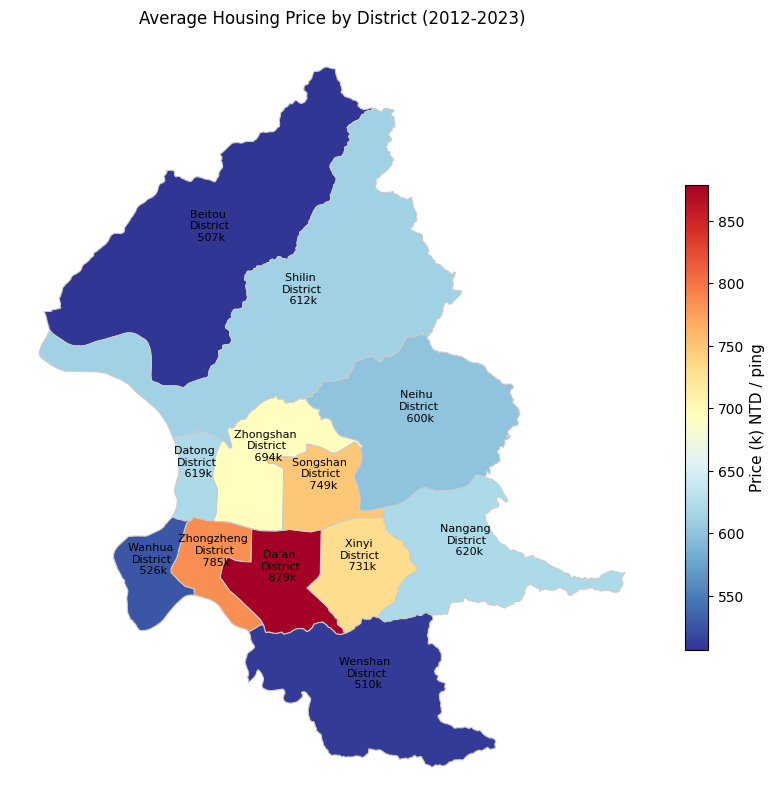

In [15]:
from matplotlib.cm import RdYlBu

gdf = gpd.GeoDataFrame(average_prices)

# map
fig, ax = plt.subplots(figsize=(10, 10))
cmap_reversed = RdYlBu.reversed()
gdf.plot(column='price_thousands', cmap=cmap_reversed, linewidth=0.8, ax=ax, edgecolor='0.8', legend=False)
plt.title('Average Housing Price by District (2012-2023)')
ax.set_axis_off()

# 在地圖上標示數值
for idx, row in gdf.iterrows():
    price_thousands = int(round(row["price"] / 1000))
    town_name = row["TOWNENG"].replace('District', '\nDistrict')
    plt.annotate(text=f'{town_name}\n {price_thousands}k', xy=(row.geometry.centroid.x, row.geometry.centroid.y), ha='center', fontsize=8)

# 取得圖例
cbar = plt.colorbar(ax.collections[0], ax=ax, orientation='vertical', fraction=0.03, pad=0.04)
cbar.set_label('Price (k) NTD / ping', fontsize=11)

plt.savefig('images/Housing_Price_Distribution_2012-2023_avg.png', dpi=300)
plt.show()

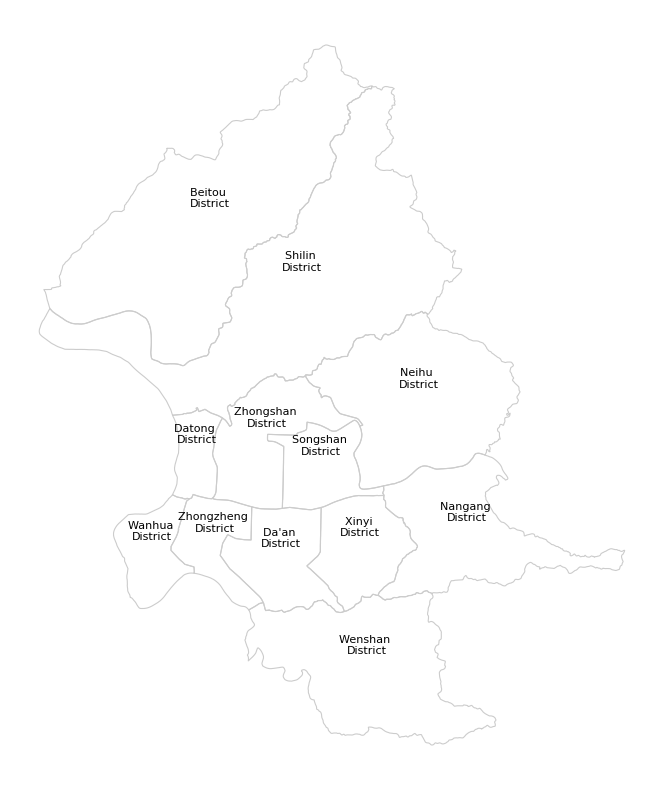

In [32]:
gdf = gpd.GeoDataFrame(average_prices)

# Plotting
fig, ax = plt.subplots(figsize=(10, 10))
gdf.boundary.plot(ax=ax, linewidth=0.8, edgecolor='#CCCCCC')

# Annotate district names
for idx, row in gdf.iterrows():
    town_name = row["TOWNENG"].replace('District', '\nDistrict')
    plt.annotate(text=f'{town_name}\n', xy=(row.geometry.centroid.x, row.geometry.centroid.y), ha='center', fontsize=8)

ax.set_axis_off()
# plt.savefig('images/Taipei_Boundary_w_Name.png', dpi=300)
plt.show()

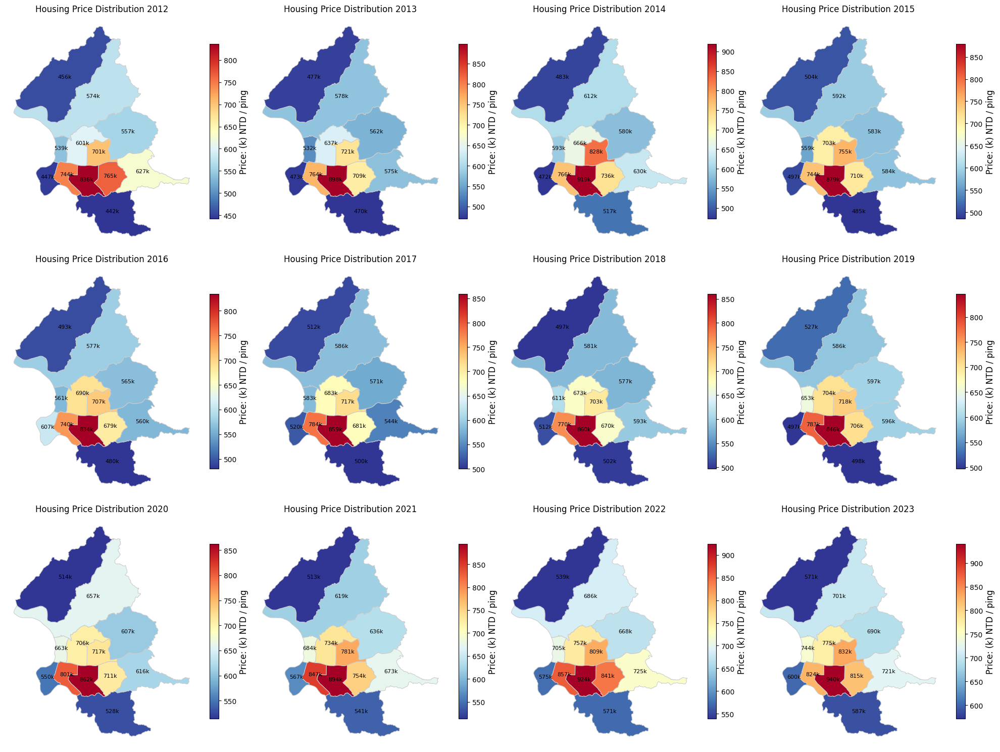

In [15]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

# 讀取地理資料
gdf = gpd.GeoDataFrame(merged_data)

# 增加新的列 price_thousands
gdf['price_thousands'] = (gdf['price'] / 1000).round().astype(int)

# 繪製地圖
fig, axs = plt.subplots(3, 4, figsize=(20, 15))

# 遍歷每個年份，繪製地圖
for i, year in enumerate(range(2012, 2024)):
    ax = axs[i//4, i%4]
    data_year = gdf[gdf['year'] == year]
    divider = make_axes_locatable(ax)
    # cax = divider.append_axes("right", size="5%", pad=0.1)
    # Reverse the colormap
    cmap_reversed = RdYlBu.reversed()
    data_year.plot(column='price_thousands', cmap=cmap_reversed, linewidth=0.8, ax=ax, edgecolor='0.8', legend=False)
    # Annotate each polygon with its price value
    for idx, row in data_year.iterrows():
        price_thousands = int(round(row["price"] / 1000))
        ax.annotate(text=f'{price_thousands}k', xy=(row.geometry.centroid.x, row.geometry.centroid.y), ha='center', fontsize=8)
    ax.set_title(f'Housing Price Distribution {year}')
    ax.set_axis_off()

    # 取得圖例
    cbar = plt.colorbar(ax.collections[0], ax=ax, orientation='vertical', fraction=0.04, pad=0.03)
    cbar.set_label('Price: (k) NTD / ping', fontsize=12)

plt.tight_layout()
plt.savefig('images/Housing_Price_Distribution_2012-2023.png', dpi=300)
plt.show()

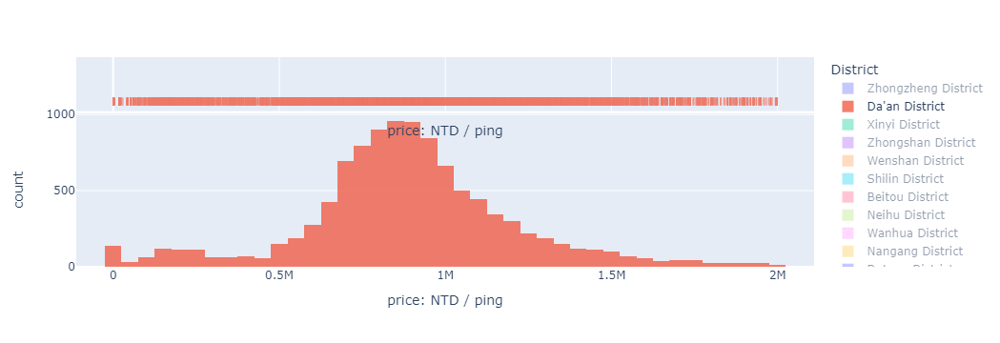

In [91]:
district_price = df.reset_index()[['District', 'price: NTD/ping']].dropna()
district_price = district_price[district_price['price: NTD/ping'] < 2000000]

import plotly.express as px
fig = px.histogram(district_price, x="price: NTD/ping", color="District", marginal="rug", nbins=50) # can be `box`, `violin`)

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.update_xaxes(title_text="price: NTD / ping")

fig.show()

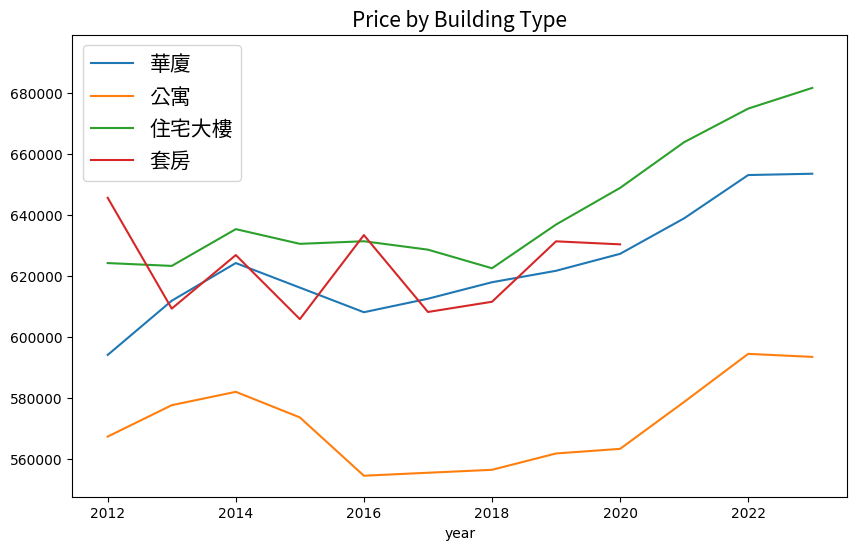

In [95]:
types = ['華廈', '公寓', '住宅大樓', '套房']#'店面', '套房', '其他', '農舍', '倉庫', '廠辦', '透天厝', '工廠']

building_type_prices = {}
for building_type in types:
    cond = (
        (df['主要用途'] == '住家用')
        & (df['price: NTD/ping'] < df["price: NTD/ping"].quantile(0.8))
        & (df['price: NTD/ping'] > df["price: NTD/ping"].quantile(0.2))
        & (df['建物型態2'] == building_type)
        )
    building_type_prices[building_type] = df[cond]['price: NTD/ping'].groupby(df[cond]['year']).mean().loc[2012:]
pd.DataFrame(building_type_prices).plot()
plt.title('Price by Building Type',fontproperties=myfont)
plt.legend(prop=myfont)
plt.savefig('images/p_building_type', dpi=300)
plt.show()

In [96]:
#@title 價格與漲跌的相關性
import numpy as np
mean_value = price_history.mean()

gain = (price_history.iloc[-1] /  price_history.iloc[0])
mean = price_history.mean()

compare = pd.DataFrame({'上漲幅度': gain, '平均價格': mean}).dropna()
corr = (compare.corr().iloc[0,1])

print('correlation：', corr)
if corr > 0:
  print('Prices tend to retain their value better when they are higher.')
else:
  print('Prices tend to retain their value better when they are lower.')
print()

correlation： -0.6871849371986465
Prices tend to retain their value better when they are lower.



### Maps

In [97]:
with open('data/mapbox_api_key.json', 'r') as f:
    token = json.load(f)['key']

In [98]:
import xml.etree.ElementTree as ET

# Path to your KML file
file_path = "address_geocoding_kml/data/raw_json/data_1.kml"

# Initialize lists to store data
addresses = []
towns = []
districts = []
years = []
coordinates = []

# Parse the KML file
tree = ET.parse(file_path)
root = tree.getroot()

# Iterate over Placemark elements
for placemark in root.findall(".//{http://www.opengis.net/kml/2.2}Placemark"):
    # Extract relevant data
    address = placemark.find(".//{http://www.opengis.net/kml/2.2}SimpleData[@name='土地位置建物門牌']").text
    town = placemark.find(".//{http://www.opengis.net/kml/2.2}SimpleData[@name='鄉鎮市區']").text
    district = placemark.find(".//{http://www.opengis.net/kml/2.2}SimpleData[@name='District']").text
    year = placemark.find(".//{http://www.opengis.net/kml/2.2}SimpleData[@name='year']").text
    
    # Extract coordinates
    coordinates_str = placemark.find(".//{http://www.opengis.net/kml/2.2}coordinates").text
    lon, lat = [float(coord) for coord in coordinates_str.split(",")[:2]]  # Extract only longitude and latitude
    
    # Store the data in lists
    addresses.append(address)
    towns.append(town)
    districts.append(district)
    years.append(year)
    coordinates.append(Point(lon, lat))

# Create a GeoDataFrame
data = {
    'Address': addresses,
    'Town': towns,
    'District': districts,
    'Year': years,
    'Coordinates': coordinates
}
gdf = gpd.GeoDataFrame(data, geometry='Coordinates')

# Print the GeoDataFrame
gdf.head()

,Address,Town,District,Year,Coordinates
0,臺北市中正區中華路一段７號十一樓之5,中正區,Zhongzheng District,2012,POINT (121.51036 25.04705)
1,臺北市大安區潮州街６５號五樓,大安區,Da'an District,2012,POINT (121.52528 25.02913)
2,台北市中山區恆安里新生北路三段１6號9樓之1,中山區,Zhongshan District,2012,POINT (121.52740 25.06341)
3,臺北市中正區中華路一段７號八樓之5,中正區,Zhongzheng District,2012,POINT (121.50957 25.04549)
4,臺北市文山區保儀路６２之２號１６樓,文山區,Wenshan District,2012,POINT (121.56852 24.98760)


In [99]:
gdf

,Address,Town,District,Year,Coordinates
0,臺北市中正區中華路一段７號十一樓之5,中正區,Zhongzheng District,2012,POINT (121.51036 25.04705)
1,臺北市大安區潮州街６５號五樓,大安區,Da'an District,2012,POINT (121.52528 25.02913)
2,台北市中山區恆安里新生北路三段１6號9樓之1,中山區,Zhongshan District,2012,POINT (121.52740 25.06341)
3,臺北市中正區中華路一段７號八樓之5,中正區,Zhongzheng District,2012,POINT (121.50957 25.04549)
4,臺北市文山區保儀路６２之２號１６樓,文山區,Wenshan District,2012,POINT (121.56852 24.98760)
...,...,...,...,...,...
2495,台北市大安區和平東路二段１０７巷２９號６樓之１,大安區,Da'an District,2012,POINT (121.54067 25.02716)
2496,台北市大安區永康街６９號四樓,大安區,Da'an District,2012,POINT (121.52983 25.02906)
2497,台北市大安區永康街69號5樓,大安區,Da'an District,2012,POINT (121.52983 25.02906)
2498,台北市大同區大龍街１２６號四樓之２,大同區,Datong District,2012,POINT (121.51592 25.06692)


In [100]:
import folium

# Initialize the Folium map
m = folium.Map(location=[25.06, 121.5654177], zoom_start=11.51)  # Set initial location and zoom level

# Add house points to the map
for idx, row in gdf.iterrows():
    folium.CircleMarker(location=[row['Coordinates'].y, row['Coordinates'].x],
                        radius=3,  # Adjust the radius as needed
                        color='blue',
                        fill=True,
                        fill_color='blue').add_to(m)

# Display the map
m

In [23]:
# Step 1: Read the CSV file into a DataFrame
df_mrt = pd.read_csv('address_geocoding_kml/data/raw_json/Taipei_mrt_exit.csv', encoding='Big5')
df_mrt = df_mrt.rename(columns={'經度': 'longitude', '緯度': 'latitude'})
# Step 2: Create a GeoDataFrame
# Assuming the CSV contains 'latitude' and 'longitude' columns
gdf_mrt = gpd.GeoDataFrame(df_mrt, geometry=gpd.points_from_xy(df_mrt.longitude, df_mrt.latitude))
gdf_mrt

,項次,出入口名稱,出入口編號,longitude,latitude,是否為無障礙用,geometry
0,1,頂埔站出口1,1,121.418336,24.959327,是,POINT (121.41834 24.95933)
1,2,頂埔站出口2,2,121.418357,24.958947,否,POINT (121.41836 24.95895)
2,3,頂埔站出口3,3,121.419280,24.959503,是,POINT (121.41928 24.95950)
3,4,頂埔站出口4,4,121.419969,24.960255,是,POINT (121.41997 24.96026)
4,5,松山機場站出口1,1,121.552043,25.063631,是,POINT (121.55204 25.06363)
...,...,...,...,...,...,...,...
382,383,板橋站出口5,5,121.464312,25.015502,是,POINT (121.46431 25.01550)
383,384,新埔民生站出口,0,121.466839,25.026125,是,POINT (121.46684 25.02613)
384,385,幸福站出口1,1,121.460146,25.050126,是,POINT (121.46015 25.05013)
385,386,幸福站出口2,2,121.460236,25.049759,否,POINT (121.46024 25.04976)


In [102]:
# Convert the GeoDataFrame to GeoJSON
taipei_districts_json = District_data.to_json()

# Add the district boundaries to the map
folium.GeoJson(taipei_districts_json).add_to(m)

# Display the map
m

<Axes: >

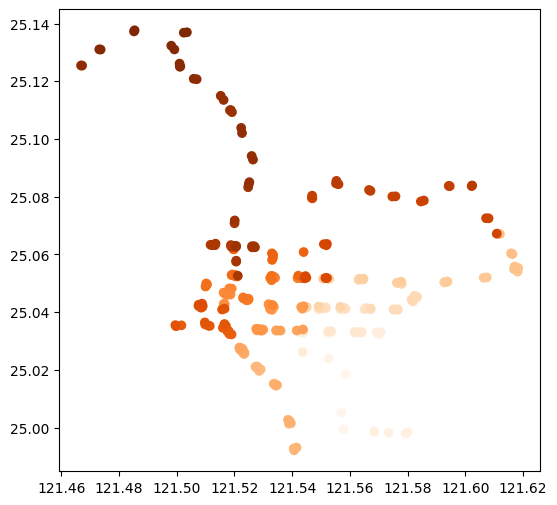

In [25]:
# mrt stations in Taipei City
clip_station = gpd.clip(gdf_mrt, District_data)
clip_station
clip_station.plot(cmap = 'Oranges')

In [26]:
clip_station

,項次,出入口名稱,出入口編號,longitude,latitude,是否為無障礙用,geometry
23,24,萬芳醫院站出口,0,121.557737,24.999383,是,POINT (121.55774 24.99938)
22,23,辛亥站出口,0,121.557021,25.005119,是,POINT (121.55702 25.00512)
21,22,麟光站出口,0,121.558606,25.018554,是,POINT (121.55861 25.01855)
20,21,六張犁站出口,0,121.552737,25.023852,是,POINT (121.55274 25.02385)
258,259,台北101/世貿站出口3,3,121.563646,25.032742,是,POINT (121.56365 25.03274)
...,...,...,...,...,...,...,...
158,159,北投站出口1,1,121.498119,25.132327,是,POINT (121.49812 25.13233)
161,162,新北投站出口2,2,121.502455,25.136834,否,POINT (121.50245 25.13683)
160,161,新北投站出口1,1,121.503524,25.136968,是,POINT (121.50352 25.13697)
163,164,復興崗站出口2,2,121.485199,25.137276,是,POINT (121.48520 25.13728)


In [27]:
for idx, row in gdf_mrt.iterrows():
    folium.CircleMarker(location=[row['geometry'].y, row['geometry'].x],
                        radius=3,  # Adjust the radius as needed
                        color='yellow',
                        fill=True,
                        fill_color='yellow').add_to(m)

# Add points to the map
for idx, row in clip_station.iterrows():
    folium.CircleMarker(location=[row['geometry'].y, row['geometry'].x],
                        radius=3,  # Adjust the radius as needed
                        color='red',
                        fill=True,
                        fill_color='red').add_to(m)

# Display the map
m

In [28]:
from routingpy.routers import MapboxOSRM
mb = MapboxOSRM(api_key = token)

In [29]:
def mb_isochrone(gdf, time = [5, 10, 15], profile = "walking"):

    # Grab X and Y values in 4326
    gdf['LON_VALUE'] = gdf.to_crs(4326).geometry.x
    gdf['LAT_VALUE'] = gdf.to_crs(4326).geometry.y

    coordinates = gdf[['LON_VALUE', 'LAT_VALUE']].values.tolist()

    # Build a list of shapes
    isochrone_shapes = []

    #meters_per_minute = speed * 1000 / 60 #km per hour to m per minute

    if type(time) is not list:
        time = [time]

    # Use minutes as input, but the API requires seconds
    time_seconds = [60 * x for x in time]

    # Given the way that routingpy works, we need to iterate through the list of 
    # coordinate pairs, then iterate through the object returned and extract the 
    # isochrone geometries.  
    for c in coordinates:
        iso_request = mb.isochrones(locations = c, profile = profile,
                                    intervals = time_seconds, polygons = "true")

        for i in iso_request:
            if i.geometry:  # check no empty geometry
                iso_geom = Polygon(i.geometry[0])
                isochrone_shapes.append(iso_geom)

    # Here, we re-build the dataset but with isochrone geometries
    df_values = gdf.drop(columns = ['geometry', 'LON_VALUE', 'LAT_VALUE'])

    time_col = time * len(df_values)

    # We'll need to repeat the dataframe to account for multiple time intervals
    df_values_rep = pd.DataFrame(np.repeat(df_values.values, len(time_seconds), axis = 0))
    df_values_rep.columns = df_values.columns

    isochrone_gdf = gpd.GeoDataFrame(
        data = df_values_rep,
        geometry = isochrone_shapes,
        crs = 4326
    )

    isochrone_gdf['time'] = time_col

    # We are sorting the dataframe in descending order of time to improve visualization
    # (the smallest isochrones should go on top, which means they are plotted last)
    isochrone_gdf = isochrone_gdf.sort_values('time', ascending = False)

    return(isochrone_gdf)

In [30]:
# 將 GeoDataFrame 的 CRS 設置為特定的坐標系統
clip_station.crs = "EPSG:4326"  # 例如，WGS84坐標系統

# 使用mb_isochrone之前，確保 GeoDataFrame 的幾何列具有 CRS
clip_station.set_crs(epsg=4326, inplace=True)

# 確保 CRS 設置完成後再使用 mb_isochrone 函數
library_isos_t5 = mb_isochrone(clip_station, time=5, profile="walking")

# 顯示結果
library_isos_t5.explore()

C:\Users\jeremychen\AppData\Local\Programs\Python\Python310\lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\jeremychen\AppData\Local\Programs\Python\Python310\lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\jeremychen\AppData\Local\Programs\Python\Python310\lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFram

In [31]:
library_isos_t5

,項次,出入口名稱,出入口編號,longitude,latitude,是否為無障礙用,geometry,time
0,24,萬芳醫院站出口,0,121.557737,24.999383,是,"POLYGON ((121.55674 25.00251, 121.55366 25.001...",5
183,97,中正紀念堂站出口1,1,121.517599,25.033345,是,"POLYGON ((121.51760 25.03690, 121.51660 25.037...",5
189,107,小南門站出口4,4,121.511455,25.035226,否,"POLYGON ((121.51145 25.03862, 121.50946 25.037...",5
188,101,中正紀念堂站出口5,5,121.517071,25.035221,是,"POLYGON ((121.51807 25.03834, 121.51707 25.038...",5
187,103,中正紀念堂站出口7,7,121.515983,25.034565,否,"POLYGON ((121.51698 25.03765, 121.51598 25.036...",5
...,...,...,...,...,...,...,...,...
98,75,萬隆站出口1,1,121.538896,25.001367,否,"POLYGON ((121.53890 25.00557, 121.53690 25.004...",5
99,76,萬隆站出口2,2,121.539562,25.001509,否,"POLYGON ((121.53856 25.00551, 121.53580 25.002...",5
100,77,萬隆站出口3,3,121.539195,25.002215,否,"POLYGON ((121.53920 25.00623, 121.53722 25.005...",5
101,78,萬隆站出口4,4,121.538572,25.002676,是,"POLYGON ((121.53857 25.00685, 121.53586 25.004...",5


In [104]:
from folium.plugins import MarkerCluster

# Create a map centered at a specific location
m3 = folium.Map(location=[25.06, 121.55], zoom_start=12.5)


# Add isochrones to the map
for idx, row in library_isos_t5.iterrows():
    folium.GeoJson(row['geometry']).add_to(m3)

# Add house points to the map
for idx, row in gdf.iterrows():
    folium.CircleMarker(location=[row['Coordinates'].y, row['Coordinates'].x],
                        radius=3,  # Adjust the radius as needed
                        color='blue',
                        fill=True,
                        fill_color='blue').add_to(m3)
# Add points to the map
for idx, row in clip_station.iterrows():
    folium.CircleMarker(location=[row['geometry'].y, row['geometry'].x],
                        radius=3,  # Adjust the radius as needed
                        color='red',
                        fill=True,
                        fill_color='red').add_to(m3)

# Display the map
m3

C:\Users\jeremychen\AppData\Local\Temp\ipykernel_39076\1312189045.py:2: UserWarning:

CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326




<Axes: >

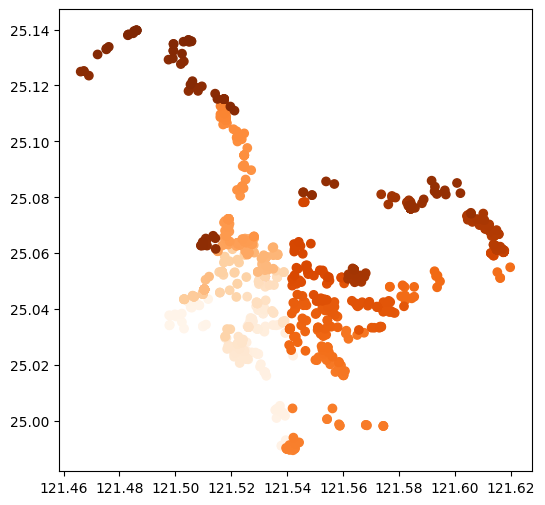

In [33]:
# gdf house within 5-min walk to mrt stations in Taipei City
clip_house = gpd.clip(gdf, library_isos_t5)
clip_house.plot(cmap = 'Oranges')

In [34]:
clip_house

,Address,Town,District,Year,Coordinates
364,臺北市中正區博愛路２２４巷８號,中正區,Zhongzheng District,2012,POINT (121.50983 25.03386)
354,臺北市中正區博愛路２２４巷８號四樓,中正區,Zhongzheng District,2012,POINT (121.50983 25.03386)
2267,台北市萬華區艋舺大道８６巷１２號５樓之１,萬華區,Wanhua District,2012,POINT (121.50308 25.03304)
2399,台北市萬華區大理街１０８號七樓,萬華區,Wanhua District,2012,POINT (121.49783 25.03419)
1248,台北市萬華區大理街１０３號１１樓,萬華區,Wanhua District,2012,POINT (121.49798 25.03438)
...,...,...,...,...,...
1684,台北市北投區中央北路三段４０巷３４弄２號四樓,北投區,Beitou District,2012,POINT (121.48520 25.13943)
2353,台北市北投區中央北路三段４０巷３４弄１８號１０樓,北投區,Beitou District,2012,POINT (121.48616 25.13969)
512,台北市北投區中央北路三段40巷34弄18號3樓之2,北投區,Beitou District,2012,POINT (121.48616 25.13969)
2323,台北市北投區中央北路三段４０巷３４弄１８號５樓之１,北投區,Beitou District,2012,POINT (121.48616 25.13969)


In [106]:
# Create a map centered at a specific location
m4 = folium.Map(location=[25.06, 121.55], zoom_start=12.5)

# Add isochrones to the map
for idx, row in library_isos_t5.iterrows():
    folium.GeoJson(row['geometry']).add_to(m4)

# Add house points to the map
for idx, row in clip_house.iterrows():
    folium.CircleMarker(location=[row['Coordinates'].y, row['Coordinates'].x],
                        radius=3,  # Adjust the radius as needed
                        color='blue',
                        fill=True,
                        fill_color='blue').add_to(m4)

# Add points to the map
for idx, row in clip_station.iterrows():
    folium.CircleMarker(location=[row['geometry'].y, row['geometry'].x],
                        radius=3,  # Adjust the radius as needed
                        color='red',
                        fill=True,
                        fill_color='red').add_to(m4)

# Display the map
m4

In [57]:
gdf.rename(columns={'土地位置建物門牌': 'Address'}, inplace=True)
gdf.rename(columns={'year': 'Year'}, inplace=True)
subset_columns = ['Address', 'Coordinates'] 
gdf = gdf.drop_duplicates(subset=subset_columns)
gdf

,Address,Town,District,Year,Coordinates
0,臺北市中正區中華路一段７號十一樓之5,中正區,Zhongzheng District,2012,POINT (121.51036 25.04705)
1,臺北市大安區潮州街６５號五樓,大安區,Da'an District,2012,POINT (121.52528 25.02913)
2,台北市中山區恆安里新生北路三段１6號9樓之1,中山區,Zhongshan District,2012,POINT (121.52740 25.06341)
3,臺北市中正區中華路一段７號八樓之5,中正區,Zhongzheng District,2012,POINT (121.50957 25.04549)
4,臺北市文山區保儀路６２之２號１６樓,文山區,Wenshan District,2012,POINT (121.56852 24.98760)
...,...,...,...,...,...
2495,台北市大安區和平東路二段１０７巷２９號６樓之１,大安區,Da'an District,2012,POINT (121.54067 25.02716)
2496,台北市大安區永康街６９號四樓,大安區,Da'an District,2012,POINT (121.52983 25.02906)
2497,台北市大安區永康街69號5樓,大安區,Da'an District,2012,POINT (121.52983 25.02906)
2498,台北市大同區大龍街１２６號四樓之２,大同區,Datong District,2012,POINT (121.51592 25.06692)


In [58]:
subset_columns = ['Address', 'Coordinates'] 
clip_house = clip_house.drop_duplicates(subset=subset_columns)
clip_house

,Address,Town,District,Year,Coordinates
364,臺北市中正區博愛路２２４巷８號,中正區,Zhongzheng District,2012,POINT (121.50983 25.03386)
354,臺北市中正區博愛路２２４巷８號四樓,中正區,Zhongzheng District,2012,POINT (121.50983 25.03386)
2267,台北市萬華區艋舺大道８６巷１２號５樓之１,萬華區,Wanhua District,2012,POINT (121.50308 25.03304)
2399,台北市萬華區大理街１０８號七樓,萬華區,Wanhua District,2012,POINT (121.49783 25.03419)
1248,台北市萬華區大理街１０３號１１樓,萬華區,Wanhua District,2012,POINT (121.49798 25.03438)
...,...,...,...,...,...
1684,台北市北投區中央北路三段４０巷３４弄２號四樓,北投區,Beitou District,2012,POINT (121.48520 25.13943)
2353,台北市北投區中央北路三段４０巷３４弄１８號１０樓,北投區,Beitou District,2012,POINT (121.48616 25.13969)
512,台北市北投區中央北路三段40巷34弄18號3樓之2,北投區,Beitou District,2012,POINT (121.48616 25.13969)
2323,台北市北投區中央北路三段４０巷３４弄１８號５樓之１,北投區,Beitou District,2012,POINT (121.48616 25.13969)


house is within the 5-min walk to MRT Station

In [70]:
address_district_df

,Address,鄉鎮市區,District,Year,price: NTD/ping
2012-01-01,臺北市中正區中華路一段７號十一樓之5,中正區,Zhongzheng District,2012,8.058260e+05
2012-01-01,臺北市大安區潮州街６５號五樓,大安區,Da'an District,2012,1.017175e+06
2012-01-03,台北市中山區恆安里新生北路三段１6號9樓之1,中山區,Zhongshan District,2012,6.585233e+05
2012-01-05,臺北市中正區中華路一段７號八樓之5,中正區,Zhongzheng District,2012,8.116871e+05
2012-01-05,臺北市文山區保儀路６２之２號１６樓,文山區,Wenshan District,2012,5.259181e+05
...,...,...,...,...,...
NaT,臺北市北投區大同街109號5樓,北投區,Beitou District,2015,6.823878e+05
NaT,臺北市中山區民權東路三段５９號二樓,中山區,Zhongshan District,2015,8.944245e+05
NaT,臺北市中山區民權東路三段５９號三樓,中山區,Zhongshan District,2015,8.944245e+05
NaT,臺北市中山區民權東路三段５９號四樓,中山區,Zhongshan District,2015,8.944245e+05


In [74]:
filtered_clip_house_price_df = address_district_df[address_district_df['Address'].isin(clip_house['Address'])]
subset_columns = ['Address'] 
filtered_clip_house_price_df = filtered_clip_house_price_df.drop_duplicates(subset=subset_columns)

filtered_clip_house_price_df

,Address,鄉鎮市區,District,Year,price: NTD/ping
2012-01-01,臺北市中正區中華路一段７號十一樓之5,中正區,Zhongzheng District,2012,805825.98198
2012-01-03,台北市中山區恆安里新生北路三段１6號9樓之1,中山區,Zhongshan District,2012,658523.28537
2012-01-05,臺北市中正區中華路一段７號八樓之5,中正區,Zhongzheng District,2012,811687.14765
2012-01-18,臺北市中正區金山南路一段１８號二樓,中正區,Zhongzheng District,2012,755336.65131
2012-01-18,臺北市中正區中華路一段７號十一樓之７,中正區,Zhongzheng District,2012,824844.19185
...,...,...,...,...,...
2012-11-23,台北市中山區恆安里新生北路三段１6號2樓,中山區,Zhongshan District,2012,650549.71989
2012-11-24,台北市文山區萬芳路６０之２號六樓,文山區,Wenshan District,2012,578853.74637
2012-11-24,台北市大安區和平東路二段９６巷１５弄２４號５樓,大安區,Da'an District,2012,797700.35016
2012-11-24,台北市內湖區康寧路3段99巷6弄1號4樓,內湖區,Neihu District,2012,412846.88994


house is within the 5-min walk to MRT Station [Price]

In [75]:
filtered_not_clip_house_df = gdf[~gdf['Address'].isin(clip_house['Address'])]
subset_columns = ['Address', 'Coordinates'] 
filtered_not_clip_house_df = filtered_not_clip_house_df.drop_duplicates(subset=subset_columns)
filtered_not_clip_house_df

,Address,Town,District,Year,Coordinates
1,臺北市大安區潮州街６５號五樓,大安區,Da'an District,2012,POINT (121.52528 25.02913)
4,臺北市文山區保儀路６２之２號１６樓,文山區,Wenshan District,2012,POINT (121.56852 24.98760)
5,臺北市士林區重慶北路四段２１０號十三樓,士林區,Shilin District,2012,POINT (121.51167 25.08552)
6,臺北市文山區興隆路二段２０３巷１３７號二樓,文山區,Wenshan District,2012,POINT (121.54654 25.00340)
7,臺北市中正區中華路一段７號八樓之7,中正區,Zhongzheng District,2012,POINT (121.50826 25.02601)
...,...,...,...,...,...
2494,台北市士林區忠義街１１５之２號３樓,士林區,Shilin District,2012,POINT (121.53275 25.10727)
2496,台北市大安區永康街６９號四樓,大安區,Da'an District,2012,POINT (121.52983 25.02906)
2497,台北市大安區永康街69號5樓,大安區,Da'an District,2012,POINT (121.52983 25.02906)
2498,台北市大同區大龍街１２６號四樓之２,大同區,Datong District,2012,POINT (121.51592 25.06692)


house is not within the 5-min walk to MRT Station

In [76]:
filtered_not_clip_house_price_df = address_district_df[address_district_df['Address'].isin(filtered_not_clip_house_df['Address'])]
subset_columns = ['Address'] 
filtered_not_clip_house_price_df = filtered_not_clip_house_price_df.drop_duplicates(subset=subset_columns)

filtered_not_clip_house_price_df

,Address,鄉鎮市區,District,Year,price: NTD/ping
2012-01-01,臺北市大安區潮州街６５號五樓,大安區,Da'an District,2012,1.017175e+06
2012-01-05,臺北市文山區保儀路６２之２號１６樓,文山區,Wenshan District,2012,5.259181e+05
2012-01-08,臺北市士林區重慶北路四段２１０號十三樓,士林區,Shilin District,2012,5.060900e+05
2012-01-09,臺北市文山區興隆路二段２０３巷１３７號二樓,文山區,Wenshan District,2012,4.735445e+05
2012-01-13,臺北市中正區中華路一段７號八樓之7,中正區,Zhongzheng District,2012,8.225830e+05
...,...,...,...,...,...
2012-11-24,台北市士林區忠義街１１５之２號３樓,士林區,Shilin District,2012,5.155809e+05
2012-11-24,台北市大安區永康街６９號四樓,大安區,Da'an District,2012,9.632808e+05
2012-11-24,台北市大安區永康街69號5樓,大安區,Da'an District,2012,1.008732e+06
2012-11-24,台北市大同區大龍街１２６號四樓之２,大同區,Datong District,2012,3.309327e+05


house is not within the 5-min walk to MRT Station [Price]

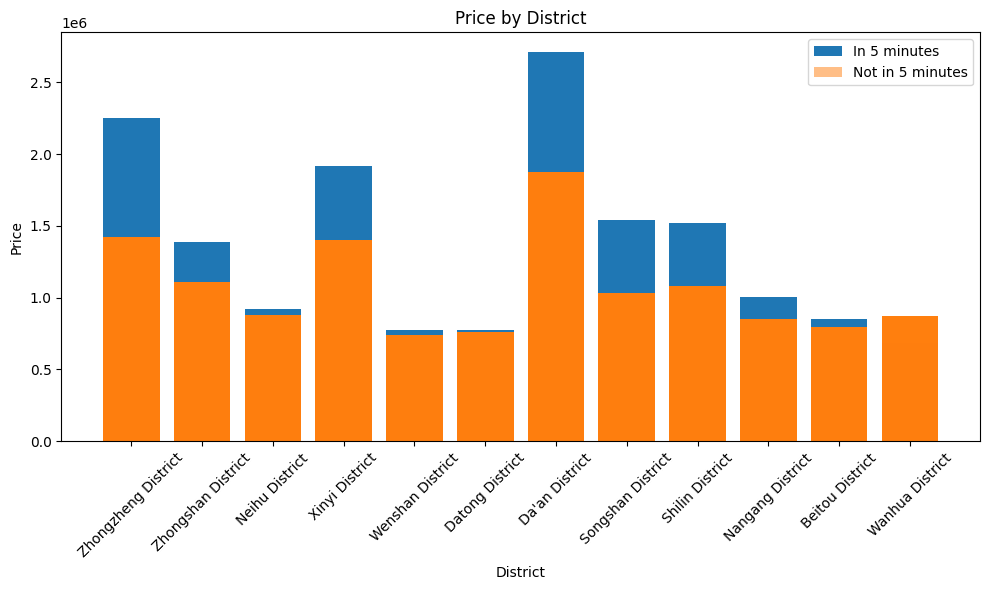

In [83]:
df_in5 = filtered_clip_house_price_df
df_not_in5 = filtered_not_clip_house_price_df

# Merge the two DataFrames on 'District'
merged_df = pd.merge(df_in5, df_not_in5, on='District')
merged_df 
# Plot the data
plt.bar(merged_df['District'], merged_df['price: NTD/ping_x'], label='In 5 minutes')
plt.bar(merged_df['District'], merged_df['price: NTD/ping_y'], label='Not in 5 minutes', alpha=0.5)
plt.xlabel('District')
plt.ylabel('Price')
plt.title('Price by District')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

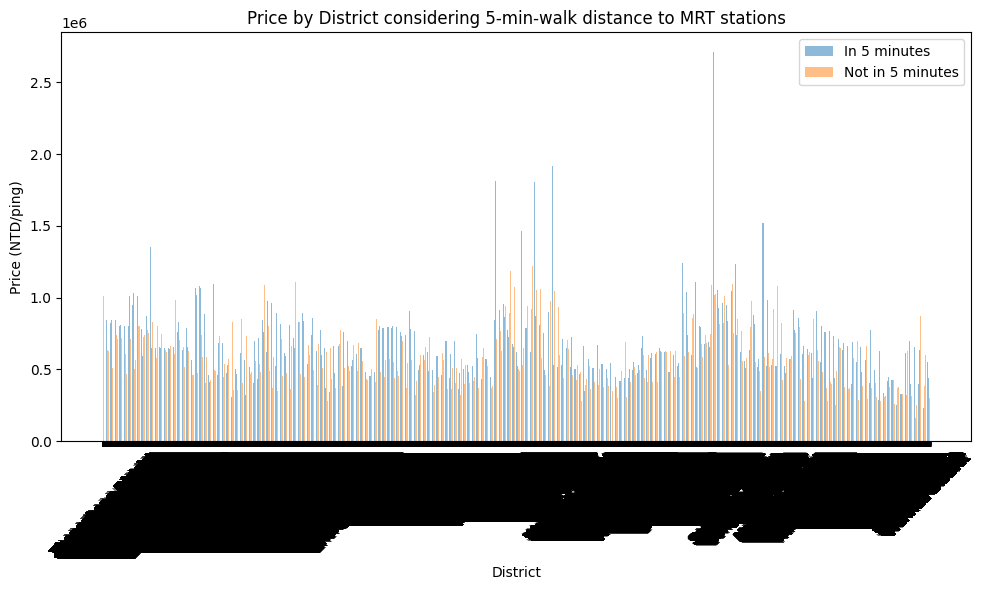

In [85]:
import numpy as np

# Define the width of each bar
bar_width = 0.35

# Define the positions for the bars
x = np.arange(len(merged_df['District']))

# Plot the data
plt.bar(x - bar_width/2, merged_df['price: NTD/ping_x'], width=bar_width, label='In 5 minutes', alpha=0.5)
plt.bar(x + bar_width/2, merged_df['price: NTD/ping_y'], width=bar_width, label='Not in 5 minutes', alpha=0.5)
plt.xlabel('District')
plt.ylabel('Price (NTD/ping)')
plt.title('Price by District considering 5-min-walk distance to MRT stations')
plt.legend()
plt.xticks(x, merged_df['District'], rotation=45)
plt.tight_layout()
plt.show()

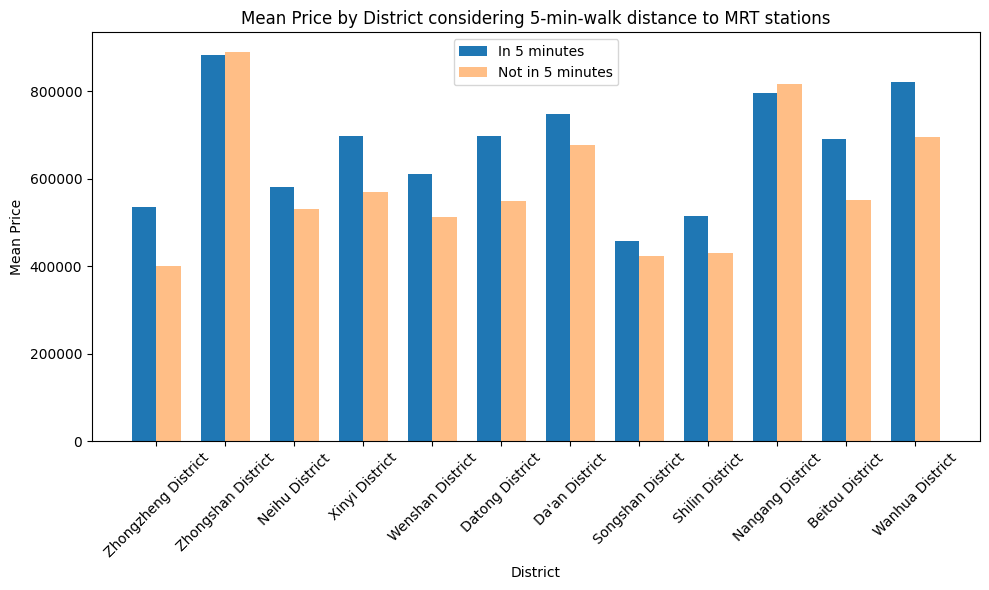

In [107]:
# Calculate the mean price for each group
mean_price_in5 = df_in5.groupby('District')['price: NTD/ping'].mean()
mean_price_not_in5 = df_not_in5.groupby('District')['price: NTD/ping'].mean()

# Get the unique districts
districts = merged_df['District'].unique()

# Define the width of each bar
bar_width = 0.35

# Define the positions for the bars
x = np.arange(len(districts))

# Plot the data
plt.bar(x - bar_width/2, mean_price_in5, width=bar_width, label='In 5 minutes')
plt.bar(x + bar_width/2, mean_price_not_in5, width=bar_width, label='Not in 5 minutes', alpha=0.5)
plt.xlabel('District')
plt.ylabel('Mean Price')
plt.title('Mean Price by District considering 5-min-walk distance to MRT stations')
plt.legend()
plt.xticks(x, districts, rotation=45)
plt.tight_layout()
plt.savefig('images/Mean_Price_by_5.png', dpi=300)
plt.show()